# Email Classifier

In this project, we read in email files through a directory and classify them as spam or 'ham' using Naive Bayes Classification.

## Imports

In [79]:
import pandas as pd
import numpy as np
from os.path import join
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import os
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import SnowballStemmer,PorterStemmer
from bs4 import BeautifulSoup

TRAINING_DATA_FILE = 'SpamData/02_Training/train-data.txt'
TEST_DATA_FILE = 'SpamData/02_Training/test-data.txt'
WORD_ID_FILE = 'SpamData/01_Processing/word-by-id.csv'
SPAM_PATH='SpamData/01_Processing/spam_assassin_corpus/spam_1'
SPAM_2_PATH = 'SpamData/01_Processing/spam_assassin_corpus/spam_2'
HAM_PATH='SpamData/01_Processing/spam_assassin_corpus/easy_ham_1'
HAM_2_PATH = 'SpamData/01_Processing/spam_assassin_corpus/easy_ham_2'
DATA_JSON_FILE='SpamData/01_Processing/email-text-data.json'

%matplotlib inline

## Reading in the email files

In [2]:
os.path

<module 'ntpath' from 'C:\\Users\\julia\\anaconda3\\lib\\ntpath.py'>

In [3]:
os.walk(SPAM_PATH)

<generator object walk at 0x000001689DEE5820>

## Create a function to obtain a list of all the email bodies from the email files of the path specified

In [4]:
def get_msg_bdy_iter(path):
    
    for root, dirs, files in os.walk(path):
        for file in files:
            file_path=os.path.join(root, file)
            #print(file_path)
            stream=open(file_path,encoding='latin-1')
            is_bdy=False
            lines=[]
            for line in stream:
                if is_bdy:
                    lines.append(line)
                elif (line=='\n'):
                    is_bdy=True
            body='\n'.join(lines)
            
            stream.close()
            yield file,body


## Create a function to return a Dataframe containing the email filenames, category of emails, message body of emails based on a given path

In [5]:
def get_df(path,cat):
    files_lst=[]
    bdys_lst=[]
    for file,body in get_msg_bdy_iter(path):
        files_lst.append(file)
        bdys_lst.append(body)
    
    df=pd.DataFrame({'Filename':files_lst, 'Category':cat,'MessageBody':bdys_lst})
    return df

## Create a DataFrame to distinguish between spam and 'ham' emails.

In [6]:
spam1_mails_df=get_df(SPAM_PATH,1)
spam2_mails_df=get_df(SPAM_2_PATH,1)

In [7]:
spam_mails_df=spam1_mails_df.append(spam2_mails_df)
spam_mails_df.head()

,Filename,Category,MessageBody
0,00001.7848dde101aa985090474a91ec93fcf0,1,"<!DOCTYPE HTML PUBLIC ""-//W3C//DTD HTML 4.0 Tr..."
1,00002.d94f1b97e48ed3b553b3508d116e6a09,1,1) Fight The Risk of Cancer!\n\nhttp://www.adc...
2,00003.2ee33bc6eacdb11f38d052c44819ba6c,1,1) Fight The Risk of Cancer!\n\nhttp://www.adc...
3,00004.eac8de8d759b7e74154f142194282724,1,##############################################...
4,00005.57696a39d7d84318ce497886896bf90d,1,I thought you might like these:\n\n1) Slim Dow...


In [8]:
ham1_mails_df=get_df(HAM_PATH,0)
ham2_mails_df=get_df(HAM_2_PATH,0)

In [9]:
ham_mails_df=ham1_mails_df.append(ham2_mails_df)
ham_mails_df.head()

,Filename,Category,MessageBody
0,00001.7c53336b37003a9286aba55d2945844c,0,"Date: Wed, 21 Aug 2002 10:54:46 -05..."
1,00002.9c4069e25e1ef370c078db7ee85ff9ac,0,"Martin A posted:\n\nTassos Papadopoulos, the G..."
2,00003.860e3c3cee1b42ead714c5c874fe25f7,0,Man Threatens Explosion In Moscow \n\n\n\nThur...
3,00004.864220c5b6930b209cc287c361c99af1,0,Klez: The Virus That Won't Die\n\n \n\nAlready...
4,00005.bf27cdeaf0b8c4647ecd61b1d09da613,0,"> in adding cream to spaghetti carbonara, whi..."


In [10]:
all_mails_df=pd.concat([spam_mails_df,ham_mails_df])

In [11]:
all_mails_df.shape

(5799, 3)

In [12]:
all_mails_df=all_mails_df.set_index('Filename')

In [13]:
all_mails_df.shape

(5799, 2)

## Determine whether there are any missing of empty email messages

In [14]:
data=all_mails_df

In [15]:

data['MessageBody'].isnull().sum()

0

In [16]:
(data.MessageBody.str.len()==0).any()

True

In [17]:
(data.MessageBody.str.len()==0).sum()

3

In [18]:
empty_str=data.loc[(data.MessageBody.str.len()==0)].index

In [19]:
data.drop(empty_str,inplace=True)

In [20]:
data.head()

,Category,MessageBody
Filename,,
00001.7848dde101aa985090474a91ec93fcf0,1,"<!DOCTYPE HTML PUBLIC ""-//W3C//DTD HTML 4.0 Tr..."
00002.d94f1b97e48ed3b553b3508d116e6a09,1,1) Fight The Risk of Cancer!\n\nhttp://www.adc...
00003.2ee33bc6eacdb11f38d052c44819ba6c,1,1) Fight The Risk of Cancer!\n\nhttp://www.adc...
00004.eac8de8d759b7e74154f142194282724,1,##############################################...
00005.57696a39d7d84318ce497886896bf90d,1,I thought you might like these:\n\n1) Slim Dow...


In [21]:
len(data)

5796

In [22]:
docids=range(0,len(data))
data['DOC_ID']=docids
data['Filename']=data.index
data.set_index('DOC_ID',inplace=True)

In [23]:
data.head()

,Category,MessageBody,Filename
DOC_ID,,,
0,1,"<!DOCTYPE HTML PUBLIC ""-//W3C//DTD HTML 4.0 Tr...",00001.7848dde101aa985090474a91ec93fcf0
1,1,1) Fight The Risk of Cancer!\n\nhttp://www.adc...,00002.d94f1b97e48ed3b553b3508d116e6a09
2,1,1) Fight The Risk of Cancer!\n\nhttp://www.adc...,00003.2ee33bc6eacdb11f38d052c44819ba6c
3,1,##############################################...,00004.eac8de8d759b7e74154f142194282724
4,1,I thought you might like these:\n\n1) Slim Dow...,00005.57696a39d7d84318ce497886896bf90d


In [24]:
data.to_json()

'{"Category":{"0":1,"1":1,"2":1,"3":1,"4":1,"5":1,"6":1,"7":1,"8":1,"9":1,"10":1,"11":1,"12":1,"13":1,"14":1,"15":1,"16":1,"17":1,"18":1,"19":1,"20":1,"21":1,"22":1,"23":1,"24":1,"25":1,"26":1,"27":1,"28":1,"29":1,"30":1,"31":1,"32":1,"33":1,"34":1,"35":1,"36":1,"37":1,"38":1,"39":1,"40":1,"41":1,"42":1,"43":1,"44":1,"45":1,"46":1,"47":1,"48":1,"49":1,"50":1,"51":1,"52":1,"53":1,"54":1,"55":1,"56":1,"57":1,"58":1,"59":1,"60":1,"61":1,"62":1,"63":1,"64":1,"65":1,"66":1,"67":1,"68":1,"69":1,"70":1,"71":1,"72":1,"73":1,"74":1,"75":1,"76":1,"77":1,"78":1,"79":1,"80":1,"81":1,"82":1,"83":1,"84":1,"85":1,"86":1,"87":1,"88":1,"89":1,"90":1,"91":1,"92":1,"93":1,"94":1,"95":1,"96":1,"97":1,"98":1,"99":1,"100":1,"101":1,"102":1,"103":1,"104":1,"105":1,"106":1,"107":1,"108":1,"109":1,"110":1,"111":1,"112":1,"113":1,"114":1,"115":1,"116":1,"117":1,"118":1,"119":1,"120":1,"121":1,"122":1,"123":1,"124":1,"125":1,"126":1,"127":1,"128":1,"129":1,"130":1,"131":1,"132":1,"133":1,"134":1,"135":1,"136":1,

## Create a pie chart

In [25]:
plt.figure(figsize=(10,6))
labels=['Spam','Ham']

cnts=data.Category.value_counts()
sizes=[cnts[1],cnts[0]]

<Figure size 720x432 with 0 Axes>

([<matplotlib.patches.Wedge at 0x168a7664c40>,
 [Text(0.5684827465619307, 0.9417151198007835, 'Spam'),
  Text(-0.5684827465619303, -0.9417151198007836, 'Ham')],
 [Text(0.3100814981246894, 0.5136627926186091, '33% '),
  Text(-0.31008149812468927, -0.5136627926186091, '67% ')])

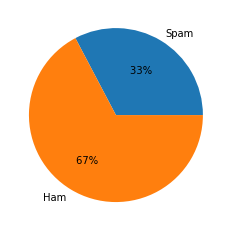

In [26]:
plt.pie(sizes,labels=labels,autopct="%1.0f%% ")

## Natural Language Processing

### We need to clean each email message by:
#### -creating lists out of the messages, i.e. tokenizing
#### -modifying to lower case
#### -removing html tags
#### -removing punctuation
#### -stemming
#### -filtering for stopwords


In [27]:
def clean_msg(msg, stemmer=PorterStemmer(), 
                 stop_words=set(stopwords.words('english'))):
   # stemmer=SnowballStemmer('english')
   # stop_words=stopwords.words('english')

    
    soup = BeautifulSoup(msg, 'html.parser')
    cleaned_text = soup.get_text()
    cleaned_words_lst=[]
    word_list=word_tokenize(cleaned_text.lower())
    
    for word in word_list:
        if word not in (stop_words) and word.isalpha():
            stemmed=stemmer.stem(word)
            cleaned_words_lst.append(stemmed)
    return(cleaned_words_lst)      



In [28]:
clean_msgs_lst=[]
#for message in data['MessageBody']:
#    clean_msgs.append(clean_msg(message))
clean_msgs_lst=data['MessageBody'].apply(clean_msg)

C:\Users\julia\anaconda3\lib\site-packages\bs4\__init__.py:417: MarkupResemblesLocatorWarning: "http://www.post-gazette.com/columnists/20020905brian5
" looks like a URL. Beautiful Soup is not an HTTP client. You should probably use an HTTP client like requests to get the document behind the URL, and feed that document to Beautiful Soup.
  warnings.warn(


In [29]:
clean_msgs_lst

DOC_ID
0       [save, life, insur, spend, life, quot, save, g...
1       [fight, risk, cancer, http, slim, guarante, lo...
2       [fight, risk, cancer, http, slim, guarante, lo...
3       [adult, club, offer, free, membership, instant...
4       [thought, might, like, slim, guarante, lose, l...
                              ...                        
5791    [http, bizarr, collect, stuf, anim, could, fet...
5792    [care, use, one, also, realli, cute, thing, ja...
5793    [sm, skip, montanaro, write, jeremi, put, anot...
5794    [mark, hammond, like, given, zodb, sound, attr...
5795    [hi, probabl, use, whatsoev, also, problem, re...
Name: MessageBody, Length: 5796, dtype: object

In [30]:
# To separate spam messages from 'ham' messages we need to obtain the DOC_IDs.
data.head()
spam_idxs=data[data['Category']==1].index
ham_idxs=data[data['Category']==0].index

In [31]:
spam_data=data.iloc[spam_idxs]
ham_data=data.iloc[ham_idxs]

In [32]:
spam_msgs_lst=clean_msgs_lst.iloc[spam_idxs]
ham_msgs_lst=clean_msgs_lst.iloc[ham_idxs]


In [33]:
spam_words_lst=[word for row in spam_msgs_lst for word in row]

In [34]:
ham_words_lst=[word for row in ham_msgs_lst for word in row]

In [35]:
spam_words_ser=pd.Series(spam_words_lst)

In [36]:
spam_cnts=spam_words_ser.value_counts()

In [37]:
spam_words=spam_cnts.index

In [38]:
spam_words

Index(['http', 'email', 'free', 'click', 'receiv', 'list', 'get', 'pleas',
       'busi', 'order',
       ...
       'cienega', 'enci', 'ndmcshjjevibsvurgdvmldytkkogshjm', 'onetim',
       'informat',
       'aaaaaaaagaaaaicpaaaaadaaaaaaaaaagaaaaicraaaaadaaaaaaaaaagaaaaiczaaaaadaaaaaa',
       'uncork', 'indicateyour', 'chevi', 'roubl'],
      dtype='object', length=13242)

In [39]:
ham_words_cnt=pd.Series(ham_words_lst).value_counts()

In [40]:
ham_words_cnt

http       7563
use        3633
list       2880
one        2373
get        2286
           ... 
ctio          1
csl           1
birdman       1
dispens       1
pomeroy       1
Length: 20815, dtype: int64

In [41]:
ham_words=ham_words_cnt.index

### Create a Vocabulary Dataframe of 2500 most common words in regular emails

In [42]:
vocab_df=pd.DataFrame(ham_words[:2500],columns=['WORD'])

In [43]:
vocab_df.head()
vocab_df.index.name='WORD_ID'

In [44]:
vocab_df.head()

,WORD
WORD_ID,
0,http
1,use
2,list
3,one
4,get


In [45]:
vocab_df.to_csv(WORD_ID_FILE, index_label=vocab_df.index.name, header=vocab_df.WORD.name)

In [46]:
pd.Index(vocab_df.WORD)


Index(['http', 'use', 'list', 'one', 'get', 'mail', 'would', 'like', 'messag',
       'work',
       ...
       'accomplish', 'infinit', 'regularli', 'emac', 'reuter', 'wipe', 'oss',
       'council', 'argv', 'district'],
      dtype='object', name='WORD', length=2500)

In [47]:
index=vocab_df.index
cond=vocab_df['WORD']=='http'
index[cond].tolist()[0]


0

In [48]:
if 'get' in set(vocab_df.WORD):
    print('yes')

yes


In [49]:
clean_msgs_lst.head()

DOC_ID
0    [save, life, insur, spend, life, quot, save, g...
1    [fight, risk, cancer, http, slim, guarante, lo...
2    [fight, risk, cancer, http, slim, guarante, lo...
3    [adult, club, offer, free, membership, instant...
4    [thought, might, like, slim, guarante, lose, l...
Name: MessageBody, dtype: object

In [50]:
sizes=[]
for row in clean_msgs_lst:
    cnt=len(row)
    sizes.append(cnt)
mx=max(sizes)
mx

7671

In [51]:
sizes=[len(row) for row in clean_msgs_lst]

In [52]:
sizes

[92,
 56,
 44,
 206,
 45,
 161,
 47,
 162,
 203,
 44,
 55,
 23,
 44,
 74,
 64,
 235,
 47,
 208,
 36,
 56,
 223,
 192,
 0,
 93,
 14,
 208,
 44,
 18,
 64,
 95,
 312,
 56,
 141,
 72,
 55,
 1066,
 48,
 139,
 2,
 90,
 78,
 4,
 47,
 70,
 44,
 75,
 38,
 12,
 38,
 63,
 47,
 51,
 71,
 80,
 25,
 275,
 36,
 63,
 19,
 18,
 14,
 40,
 57,
 18,
 77,
 28,
 102,
 41,
 226,
 68,
 120,
 5,
 52,
 0,
 40,
 40,
 208,
 0,
 40,
 146,
 62,
 114,
 64,
 253,
 1221,
 49,
 0,
 65,
 52,
 145,
 15,
 0,
 90,
 70,
 2,
 198,
 50,
 50,
 50,
 214,
 119,
 43,
 80,
 44,
 319,
 243,
 9,
 36,
 98,
 26,
 52,
 333,
 47,
 42,
 0,
 38,
 78,
 97,
 79,
 55,
 102,
 34,
 70,
 55,
 18,
 129,
 50,
 0,
 39,
 74,
 43,
 72,
 47,
 80,
 0,
 28,
 223,
 97,
 0,
 58,
 84,
 214,
 75,
 47,
 18,
 104,
 20,
 114,
 110,
 187,
 6,
 40,
 54,
 79,
 276,
 110,
 208,
 6,
 489,
 62,
 17,
 175,
 79,
 47,
 74,
 82,
 255,
 33,
 218,
 38,
 36,
 110,
 93,
 61,
 55,
 41,
 108,
 80,
 84,
 0,
 52,
 1390,
 108,
 97,
 25,
 185,
 1,
 119,
 255,
 28,
 137,
 195,
 1

In [53]:
max(sizes)

7671

In [54]:
idx_max_mail=np.argmax(sizes)

In [55]:
clean_msgs_lst.iloc[idx_max_mail]

['yahoo',
 'group',
 'sponsor',
 'dvd',
 'free',
 'p',
 'join',
 'http',
 'new',
 'version',
 'unison',
 'avail',
 'test',
 'incorpor',
 'sever',
 'small',
 'improv',
 'main',
 'chang',
 'fix',
 'bug',
 'potenti',
 'seriou',
 'safeti',
 'consequ',
 'small',
 'number',
 'user',
 'habit',
 'run',
 'one',
 'instanc',
 'unison',
 'time',
 'parallel',
 'user',
 'strongli',
 'encourag',
 'upgrad',
 'other',
 'wait',
 'wish',
 'releas',
 'includ',
 'execut',
 'linux',
 'solari',
 'window',
 'look',
 'maintain',
 'moment',
 'none',
 'activ',
 'develop',
 'regularli',
 'use',
 'unison',
 'window',
 'machin',
 'configur',
 'properli',
 'build',
 'execut',
 'export',
 'grab',
 'http',
 'enjoy',
 'benjamin',
 'chang',
 'sinc',
 'ad',
 'prefer',
 'maxthread',
 'use',
 'limit',
 'number',
 'simultan',
 'file',
 'transfer',
 'ad',
 'backupdir',
 'prefer',
 'control',
 'backup',
 'file',
 'store',
 'basic',
 'support',
 'ad',
 'osx',
 'particular',
 'unison',
 'recogn',
 'one',
 'host',
 'synchron',
 

In [56]:
data.head()

,Category,MessageBody,Filename
DOC_ID,,,
0,1,"<!DOCTYPE HTML PUBLIC ""-//W3C//DTD HTML 4.0 Tr...",00001.7848dde101aa985090474a91ec93fcf0
1,1,1) Fight The Risk of Cancer!\n\nhttp://www.adc...,00002.d94f1b97e48ed3b553b3508d116e6a09
2,1,1) Fight The Risk of Cancer!\n\nhttp://www.adc...,00003.2ee33bc6eacdb11f38d052c44819ba6c
3,1,##############################################...,00004.eac8de8d759b7e74154f142194282724
4,1,I thought you might like these:\n\n1) Slim Dow...,00005.57696a39d7d84318ce497886896bf90d


In [57]:

data.iloc[idx_max_mail].MessageBody


'------------------------ Yahoo! Groups Sponsor ---------------------~-->\n\n4 DVDs Free +s&p Join Now\n\nhttp://us.click.yahoo.com/pt6YBB/NXiEAA/Ey.GAA/26EolB/TM\n\n---------------------------------------------------------------------~->\n\n\n\nA new version of unison is now available for testing.  It incorporates\n\nseveral small improvements over 2.9.1, but the main change is a fix to\n\na bug that had potentially serious safety consequences, but only for\n\nthe very small number of users that are in the habit of running more\n\nthan one instance of Unison at a time, in parallel.  These users are\n\nstrongly encouraged to upgrade.  Others can wait if they wish.\n\n\n\nThe release includes pre-built executables for Linux and Solaris, but\n\nnot Windows.  (We are looking for a Unison-Windows maintainer -- at\n\nthe moment, none of the active developers are regularly using Unison\n\non Windows, and we do not have a machine that is configured properly\n\nfor building executables for exp

In [58]:
data.index

Int64Index([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,
            ...
            5786, 5787, 5788, 5789, 5790, 5791, 5792, 5793, 5794, 5795],
           dtype='int64', name='DOC_ID', length=5796)

In [59]:
type(clean_msgs_lst.head())

pandas.core.series.Series

In [60]:
word_col_df=pd.DataFrame.from_records(clean_msgs_lst.to_list())


In [61]:
word_col_df.shape

(5796, 7671)

In [62]:
data['Category'].shape

(5796,)

In [63]:
X_train,X_test,y_train,y_test=train_test_split(word_col_df,data['Category'],test_size=0.3,random_state=45)

In [64]:
X_train.index.name=X_test.index.name='DOC_ID'

In [65]:
X_train.head()

,0,1,2,3,4,5,6,7,8,9,...,7661,7662,7663,7664,7665,7666,7667,7668,7669,7670
DOC_ID,,,,,,,,,,,,,,,,,,,,,
506,new,product,announc,outsourc,mfg,note,inform,new,watchdog,board,...,None,None,None,None,None,None,None,None,None,None
2305,tue,sep,russel,turpin,wrote,part,angri,men,column,tabl,...,None,None,None,None,None,None,None,None,None,None
2179,tue,panu,matilainen,wrote,mon,oct,jess,keat,wrote,mon,...,None,None,None,None,None,None,None,None,None,None
2061,messag,mime,format,inlin,view,newslett,http,media,unspun,press,...,None,None,None,None,None,None,None,None,None,None
1381,sale,mg,tablet,men,viagra,viagra,propecia,ortho,vaniqa,renova,...,None,None,None,None,None,None,None,None,None,None


In [66]:
y_train.head()


DOC_ID
506     1
2305    0
2179    0
2061    0
1381    1
Name: Category, dtype: int64

## Create a sparce Matrix for the Training data

The new dataframe will have a DOC_ID, Label, Occurence, WORD_ID.

In [67]:
X_train.iloc[2,3]
y_train.index[1]
y_train.head()
y_train[2305]
nr=X_train.shape[0]
nr

4057

In [68]:
word_index = pd.Index(vocab_df.WORD)

def make_sparse_matrix(df, indexed_words, labels):
    """
    Returns sparse matrix as dataframe.
    
    df: A dataframe with words in the columns with a document id as an index (X_train or X_test)
    indexed_words: index of words ordered by word id
    labels: category as a series (y_train or y_test)
    """
    
    nr_rows = df.shape[0]
    nr_cols = df.shape[1]
    word_set = set(indexed_words)
    dict_list = []
    
    for i in range(nr_rows):
        for j in range(nr_cols):
            
            word = df.iat[i, j]
            if word in word_set:
                doc_id = df.index[i]
                word_id = indexed_words.get_loc(word)
                category = labels.at[doc_id]
                
                item = {'LABEL': category, 'DOC_ID': doc_id,
                       'OCCURENCE': 1, 'WORD_ID': word_id}
                
                dict_list.append(item)
    
    return pd.DataFrame(dict_list)

In [73]:
sparse_train_df = make_sparse_matrix(X_train, word_index, y_train)

In [74]:
train_grouped=sparse_train_df.groupby(['DOC_ID','WORD_ID','LABEL']).sum().reset_index()

In [75]:
train_grouped.head()

,DOC_ID,WORD_ID,LABEL,OCCURENCE
0,0,2,1,1
1,0,4,1,1
2,0,13,1,1
3,0,16,1,1
4,0,19,1,2


In [76]:
np.savetxt(TRAINING_DATA_FILE, train_grouped, fmt='%d')

In [77]:
sparse_test_df = make_sparse_matrix(X_test, word_index, y_test)


In [80]:
test_grouped = sparse_test_df.groupby(['DOC_ID', 'WORD_ID', 'LABEL']).sum().reset_index()
test_grouped.head()
np.savetxt(TEST_DATA_FILE, test_grouped, fmt='%d')